In [1]:
import torch
import matplotlib.pyplot as plt
import pytorch_mask_rcnn as pmr
from torchvision import transforms
from PIL import Image


use_cuda = True
dataset = "coco"
# ckpt_path = "../ckpt/maskrcnn_voc-5.pth"
ckpt_path = "./chkpt/maskrcnn_coco-100.pth"
# data_dir = "E:/PyTorch/data/voc2012/"
data_dir = "/mingback/students/jincheng/data/COCO2017"

device = torch.device("cuda" if torch.cuda.is_available() and use_cuda else "cpu")
if device.type == "cuda":
    pmr.get_gpu_prop(show=True)
print("\ndevice: {}".format(device))

ds = pmr.datasets(dataset, data_dir, "val2017", train=True)
indices = torch.randperm(len(ds)).tolist()
d = torch.utils.data.Subset(ds, indices)

model = pmr.maskrcnn_resnet50(True, len(ds.classes) + 1).to(device)
model.eval()
model.head.score_thresh = 0.3

if ckpt_path:
    checkpoint = torch.load(ckpt_path, map_location=device)
    model.load_state_dict(checkpoint["model"])
    print(checkpoint["eval_info"])
    del checkpoint
    torch.cuda.empty_cache()
    
for p in model.parameters():
    p.requires_grad_(False)

cuda: True
available GPU(s): 8
0: {'name': 'GeForce GTX 1080 Ti', 'capability': [6, 1], 'total_momory': 10.92, 'sm_count': 28}
1: {'name': 'GeForce GTX 1080 Ti', 'capability': [6, 1], 'total_momory': 10.92, 'sm_count': 28}
2: {'name': 'GeForce GTX 1080 Ti', 'capability': [6, 1], 'total_momory': 10.92, 'sm_count': 28}
3: {'name': 'GeForce GTX 1080 Ti', 'capability': [6, 1], 'total_momory': 10.92, 'sm_count': 28}
4: {'name': 'GeForce GTX 1080 Ti', 'capability': [6, 1], 'total_momory': 10.92, 'sm_count': 28}
5: {'name': 'GeForce GTX 1080 Ti', 'capability': [6, 1], 'total_momory': 10.92, 'sm_count': 28}
6: {'name': 'GeForce GTX 1080 Ti', 'capability': [6, 1], 'total_momory': 10.92, 'sm_count': 28}
7: {'name': 'GeForce GTX 1080 Ti', 'capability': [6, 1], 'total_momory': 10.92, 'sm_count': 28}

device: cuda
loading annotations into memory...
Done (t=0.88s)
creating index...
index created!
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.154
 Averag

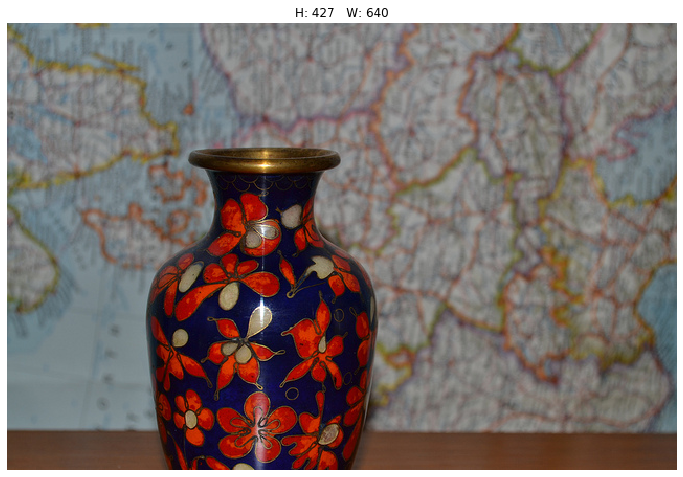

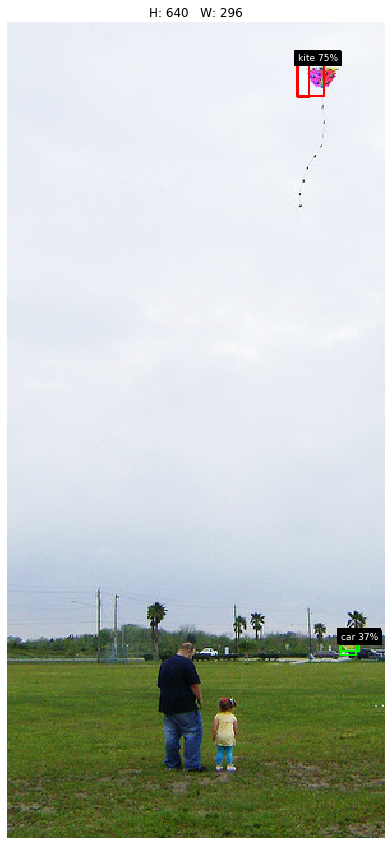

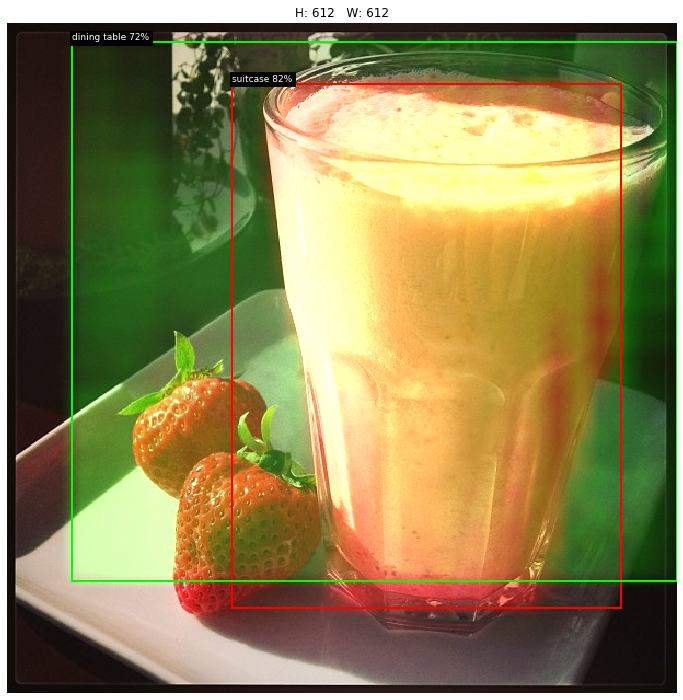

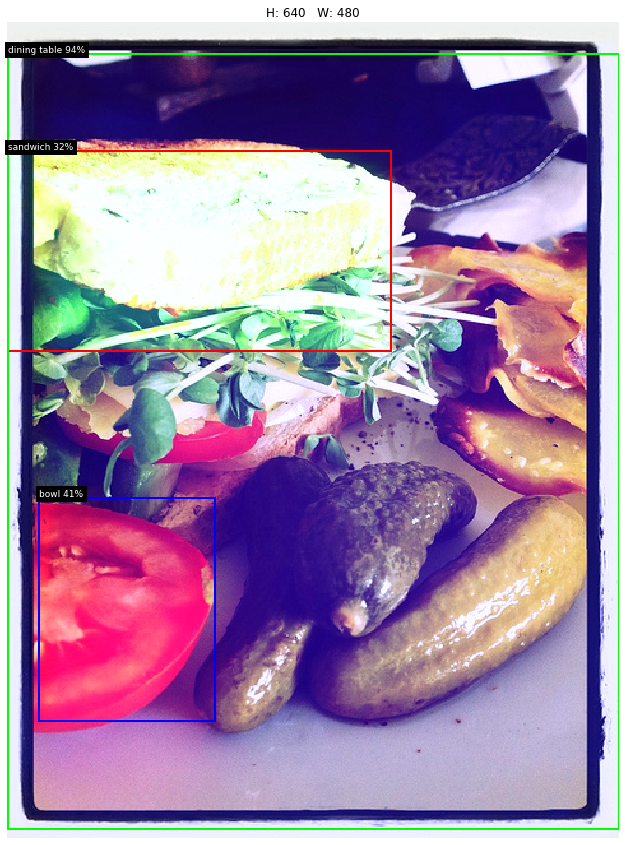

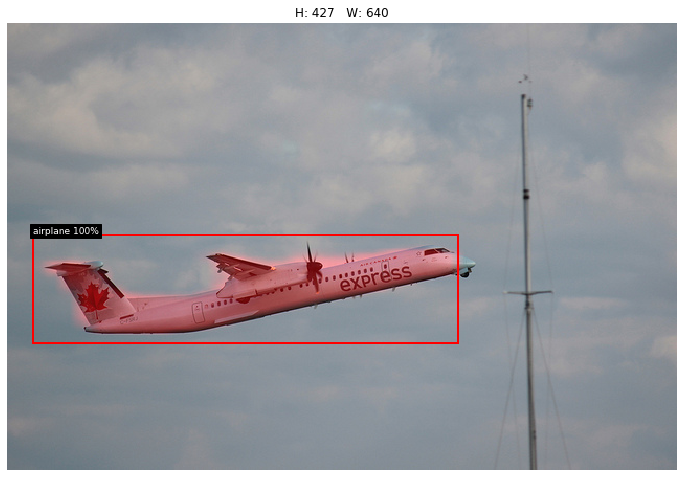

...

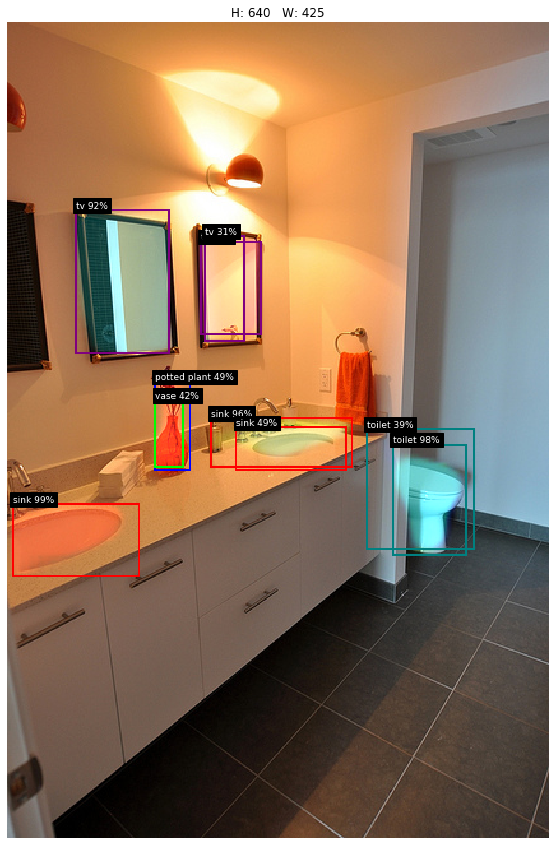

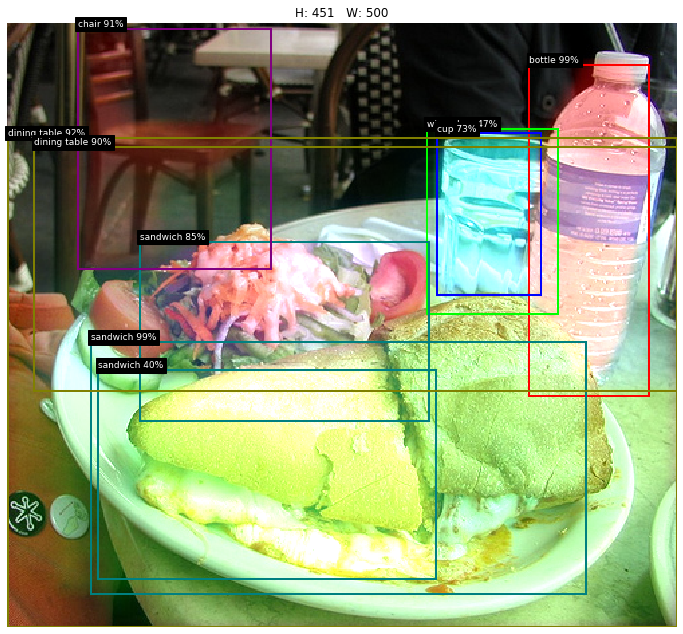

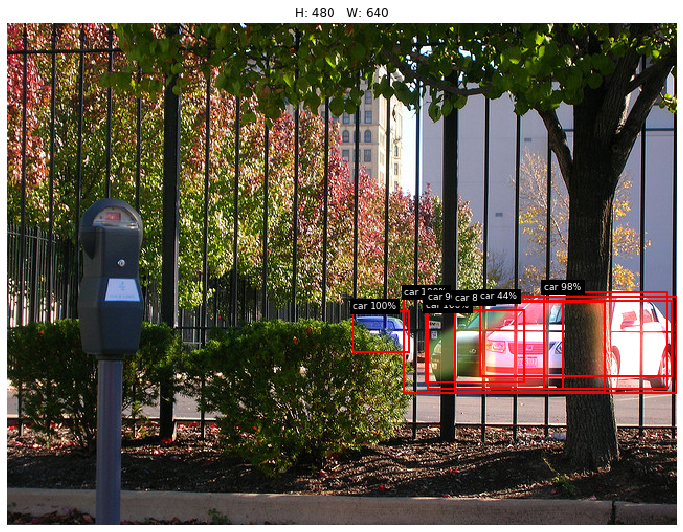

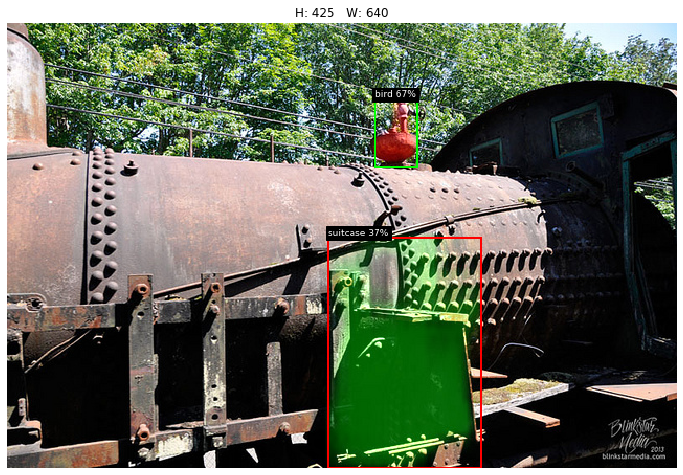

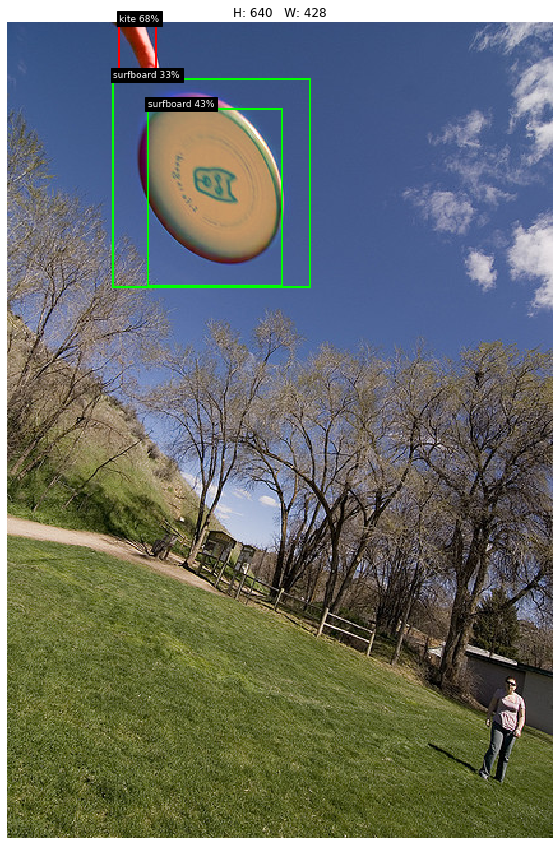

In [2]:
iters = 30

for i, (image, target) in enumerate(d):
    image = image.to(device)
    target = {k: v.to(device) for k, v in target.items()}
    
    with torch.no_grad():
        result = model(image)
        
    plt.figure(figsize=(12, 15))
    pmr.show(image, result, ds.classes)

    if i >= iters - 1:
        break

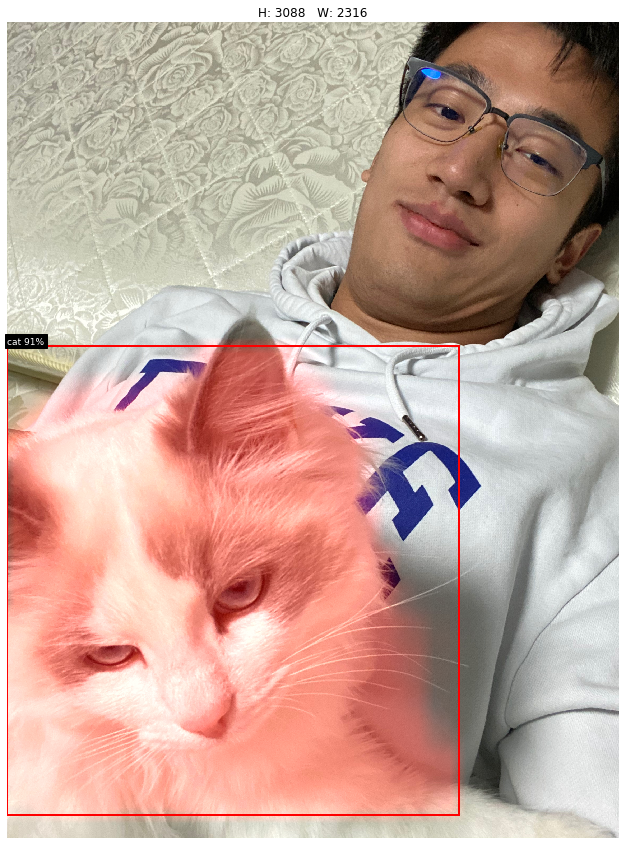

In [10]:
img_dir = "image/IMG_3437.jpeg"
image = Image.open(img_dir)
image = image.convert("RGB")
image = transforms.ToTensor()(image)
image = image.to(device)
target = {k: v.to(device) for k, v in target.items()}

with torch.no_grad():
    result = model(image)

plt.figure(figsize=(12, 15))
pmr.show(image, result, ds.classes)